<a href="https://colab.research.google.com/github/nsk20/CMPE257-Project/blob/main/257_project_checkin2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import pandas as pd
import numpy as np

In [53]:
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
import plotly.subplots as sp
import plotly.graph_objects as go
import seaborn as sns
import matplotlib.pyplot as plt
import pycountry
sns.set_style("whitegrid")

# Data Preprocessing Libraries
from datasist.structdata import detect_outliers
from sklearn.model_selection import train_test_split, StratifiedKFold, cross_validate

from sklearn.preprocessing import StandardScaler, OneHotEncoder, RobustScaler
from category_encoders import BinaryEncoder
from sklearn.impute import SimpleImputer
from imblearn.over_sampling import SMOTE

# Machine Learing (classification models) Libraries
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier
from sklearn.feature_selection import SequentialFeatureSelector, SelectKBest, f_regression, RFE, SelectFromModel
from imblearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.metrics import confusion_matrix, accuracy_score, f1_score, classification_report, roc_curve, roc_auc_score
import lightgbm as lgb
import xgboost as xgb
from sklearn.model_selection import GridSearchCV

In [3]:
df = pd.read_csv("/content/ks-projects-201801.csv")

In [4]:
df.sample(10)

,ID,name,category,main_category,currency,deadline,goal,launched,pledged,state,backers,country,usd pledged,usd_pledged_real,usd_goal_real
211064,207567722,#Haterproof T Shirts!,Fashion,Fashion,USD,2014-08-11,15000.0,2014-07-12 11:49:54,0.0,failed,0,US,0.00,0.00,15000.00
328410,743094045,Tridek - Creatures of Galena: Digital Trading ...,Video Games,Games,USD,2012-11-10,30000.0,2012-10-11 17:41:11,3592.0,failed,37,US,3592.00,3592.00,30000.00
18877,1095695324,The Art of Story,Illustration,Art,USD,2012-01-01,4000.0,2011-12-15 03:36:37,65.0,failed,2,US,65.00,65.00,4000.00
130532,1662715162,Bards of Bywater tribute to Leonard Cohen CONC...,Jazz,Music,USD,2012-03-16,16000.0,2012-02-23 20:58:34,3731.0,failed,76,US,3731.00,3731.00,16000.00
198410,2010264081,Inn on the Crooked Road (Canceled),Architecture,Design,USD,2016-01-31,30000.0,2015-12-02 23:03:17,106.0,canceled,3,US,106.00,106.00,30000.00
104449,1530879836,Explosions for Peace,Performance Art,Art,GBP,2014-12-14,5000.0,2014-11-14 12:01:17,156.0,failed,6,GB,246.06,244.11,7823.99
9134,1046130440,"Hanging Origami Cranes For ""The Wild Place"" - ...",Art,Art,USD,2014-05-23,10.0,2014-05-15 21:10:04,10.0,successful,1,US,10.00,10.00,10.00
222368,2132799397,NeoExodus Campaign Setting Update for Pathfind...,Tabletop Games,Games,USD,2015-07-08,1000.0,2015-06-01 00:17:05,13920.0,successful,257,US,13920.00,13920.00,1000.00
290561,548452848,Red Pearl,Narrative Film,Film & Video,USD,2014-05-22,6000.0,2014-04-22 20:51:44,6387.0,successful,86,US,6387.00,6387.00,6000.00
166470,1846898692,"Chief:Legends - Bring ""Fast Pace Gaming"" back ...",Video Games,Games,USD,2015-01-14,2500.0,2014-12-15 03:55:43,1.0,failed,1,US,1.00,1.00,2500.00


In [5]:
# data information
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 378661 entries, 0 to 378660
Data columns (total 15 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   ID                378661 non-null  int64  
 1   name              378657 non-null  object 
 2   category          378661 non-null  object 
 3   main_category     378661 non-null  object 
 4   currency          378661 non-null  object 
 5   deadline          378661 non-null  object 
 6   goal              378661 non-null  float64
 7   launched          378661 non-null  object 
 8   pledged           378661 non-null  float64
 9   state             378661 non-null  object 
 10  backers           378661 non-null  int64  
 11  country           378661 non-null  object 
 12  usd pledged       374864 non-null  float64
 13  usd_pledged_real  378661 non-null  float64
 14  usd_goal_real     378661 non-null  float64
dtypes: float64(5), int64(2), object(8)
memory usage: 43.3+ MB


In [6]:
df.columns

Index(['ID', 'name', 'category', 'main_category', 'currency', 'deadline',
       'goal', 'launched', 'pledged', 'state', 'backers', 'country',
       'usd pledged', 'usd_pledged_real', 'usd_goal_real'],
      dtype='object')

In [7]:
# check the dataset shape
print("Number of Columns in data",df.shape[1])
print("---------------------------------------")
print("Number of Rows in data",df.shape[0])

Number of Columns in data 15
---------------------------------------
Number of Rows in data 378661


In [8]:
df = df.drop(['ID', 'name'], axis=1)

Dropping these columns will help us for prediction as these columns are unique columns.

In [9]:
df.duplicated().sum()
df.nunique()

category               159
main_category           15
currency                14
deadline              3164
goal                  8353
launched            378089
pledged              62130
state                    6
backers               3963
country                 23
usd pledged          95455
usd_pledged_real    106065
usd_goal_real        50339
dtype: int64

In [10]:
df['country'].unique()

array(['GB', 'US', 'CA', 'AU', 'NO', 'IT', 'DE', 'IE', 'MX', 'ES', 'N,0"',
       'SE', 'FR', 'NL', 'NZ', 'CH', 'AT', 'DK', 'BE', 'HK', 'LU', 'SG',
       'JP'], dtype=object)

In [11]:
!pip install pycountry
import pycountry


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.1/10.1 MB 49.2 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for pycountry: filename=pycountry-22.3.5-py2.py3-none-any.whl size=10681832 sha256=364f8b5c4db07a2c4ddab1b1d8c7a890b7b42b958421aa5afc9437ff85dfc7ad
  Stored in directory: /root/.cache/pip/wheels/03/57/cc/290c5252ec97a6d78d36479a3c5e5ecc76318afcb241ad9dbe
Successfully built pycountry


In [12]:
def get_country_name(code):
    try:
        return pycountry.countries.get(alpha_2=code).name
    except AttributeError:
        # Handle unknown or invalid country codes
        return "Unknown"

In [13]:
df['country'] = df['country'].apply(lambda x: get_country_name(x))

In [14]:
df['country'].unique()

array(['United Kingdom', 'United States', 'Canada', 'Australia', 'Norway',
       'Italy', 'Germany', 'Ireland', 'Mexico', 'Spain', 'Unknown',
       'Sweden', 'France', 'Netherlands', 'New Zealand', 'Switzerland',
       'Austria', 'Denmark', 'Belgium', 'Hong Kong', 'Luxembourg',
       'Singapore', 'Japan'], dtype=object)

In [15]:
df['state'].value_counts()

failed        197719
successful    133956
canceled       38779
undefined       3562
live            2799
suspended       1846
Name: state, dtype: int64

In [16]:
df = df[(df['state'] == 'failed') | (df['state'] == 'successful')]

In [17]:
df['state'].value_counts()

failed        197719
successful    133956
Name: state, dtype: int64

In [18]:
df.shape

(331675, 13)

In [19]:
df.describe(include='O')

,category,main_category,currency,deadline,launched,state,country
count,331675,331675,331675,331675,331675,331675,331675
unique,159,15,14,3102,331255,2,23
top,Product Design,Film & Video,USD,2014-08-08,2013-04-07 23:30:18,failed,United States
freq,18680,56527,261511,612,2,197719,261360


In [20]:
df.describe().style.background_gradient()

,goal,pledged,backers,usd pledged,usd_pledged_real,usd_goal_real
count,331675.000000,331675.000000,331675.000000,331465.000000,331675.000000,331675.000000
mean,44251.573064,10584.003548,116.381581,7684.569010,9943.461256,41510.001543
std,1117916.699061,101591.731817,965.427268,83209.377212,96732.934175,1108929.663087
min,0.010000,0.000000,0.000000,0.000000,0.000000,0.010000
25%,2000.000000,50.000000,2.000000,25.000000,50.000000,2000.000000
50%,5000.000000,782.000000,15.000000,502.000000,788.000000,5000.000000
75%,15000.000000,4657.000000,63.000000,3421.000000,4608.000000,15000.000000
max,100000000.000000,20338986.270000,219382.000000,20338986.270000,20338986.270000,166361390.710000


Exploratory Data Analysis
Univariate Analysis

category column

In [21]:
value_counts = df['category'].value_counts()
print(value_counts)

Product Design     18680
Documentary        14523
Music              12633
Tabletop Games     11744
Shorts             11394
                   ...  
Residencies           68
Letterpress           46
Chiptune              33
Literary Spaces       19
Taxidermy             10
Name: category, Length: 159, dtype: int64


category with highest count is product design

main_category

In [22]:
import plotly.express as px
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
import plotly.subplots as sp
import plotly.graph_objects as go
import seaborn as sns
import matplotlib.pyplot as plt

sns.set_style("whitegrid")

In [23]:
fig = px.histogram(df, x='main_category',
                   title='Main category Distribution',
                   color_discrete_sequence=['#3498db'],  # Setting custom color
                  )

fig.update_traces(marker=dict(line=dict(width=2, color='DarkSlateGrey')))

# format the layout
fig.update_layout(
    xaxis=dict(showgrid=False, zeroline=False),
    yaxis=dict(zeroline=False, gridcolor='white'),
    paper_bgcolor='rgb(233,233,233)',
    plot_bgcolor='rgb(233,233,233)',
)

fig.show()

Highest count in main category is Film & Video

currency

In [24]:
fig = px.histogram(df, x='currency',
                   title='Currency Distribution',
                   color_discrete_sequence=['#3498db'],  # Setting custom color
                   )

fig.update_traces(marker=dict(line=dict(width=2, color='DarkSlateGrey')))

# format the layout
fig.update_layout(
    xaxis=dict(showgrid=False, zeroline=False),
    yaxis=dict(zeroline=False, gridcolor='white'),
    paper_bgcolor='rgb(233,233,233)',
    plot_bgcolor='rgb(233,233,233)',
)

fig.show()

USD is the most commonly used currency for most projects.

state

In [25]:
fig = px.pie(df, names='state',
             title='State Distribution',
             color_discrete_sequence=['#ff7f0e', '#3498db'],# Setting custom color
            )

# format the layout
fig.update_layout(
    xaxis=dict(showgrid=False, zeroline=False),
    yaxis=dict(zeroline=False, gridcolor='white'),
    paper_bgcolor='rgb(233,233,233)',
    plot_bgcolor='rgb(233,233,233)',
)

fig.update_traces(marker=dict(line=dict(width=2, color='DarkSlateGrey')))


# Show the pie chart
fig.show()

dataset contains a higher percentage of failed projects (59.6%) compared to successful projects (40.4%).

country

In [26]:
fig = px.histogram(df, x='country',
                   title='Country Distribution',
                   color_discrete_sequence=['#3498db'],# Setting custom color
                   )
fig.update_traces(marker=dict(line=dict(width=2, color='DarkSlateGrey')))

# format the layout
fig.update_layout(
    xaxis=dict(showgrid=False, zeroline=False),
    yaxis=dict(zeroline=False, gridcolor='white'),
    paper_bgcolor='rgb(233,233,233)',
    plot_bgcolor='rgb(233,233,233)',
)

fig.show()

 United States has the highest number of projects in the dataset.

Numerical Columns

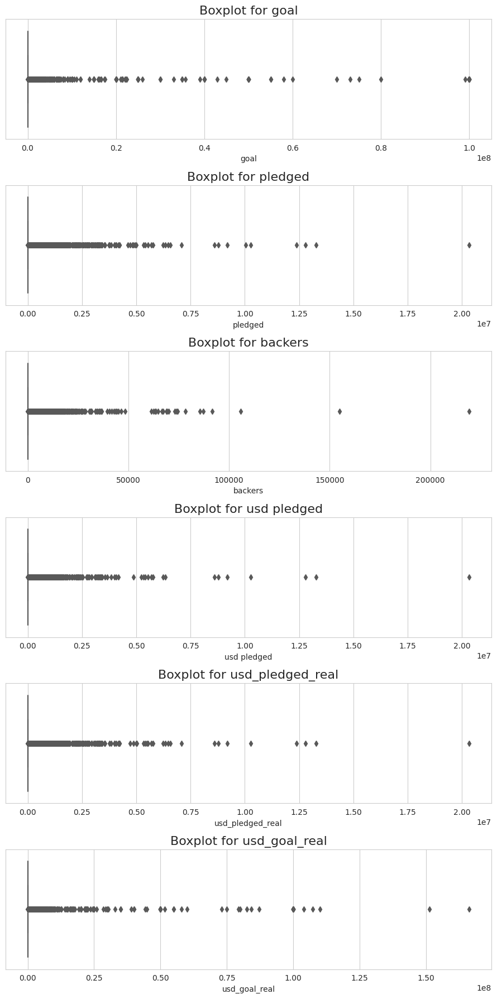

In [27]:
fig, axes = plt.subplots(6, 1, figsize=(9, 18))

numerical_features = [
   'goal','pledged', 'backers', 'usd pledged', 'usd_pledged_real', 'usd_goal_real'
]

#Looping through the subplots and create countplots for each feature
for i, ax in enumerate(axes.flat):
    if i < len(numerical_features):
        sns.boxplot(data=df, x=numerical_features[i], ax=ax, palette='Set2', orient='h')
        ax.set_title(f'Boxplot for {numerical_features[i]}', fontsize=16)

# Adjusting the layout for better visualization
plt.tight_layout()

plt.show()

The boxplot for the numerical column shows the presence of significant outliers in the dataset. These outliers align with the overall trends of the dataset and are not data errors. However, to optimize our model, it is advisable to either remove or minimize these outliers.

Bivariate Analysis

Which Top 10 categories have the highest and lowest success rates and failure rates ?

In [28]:
# Get top 10 categories in ascending order
top_categories = df['category'].value_counts().head(10).index

# Filter dataframe for top 10 categories
filtered_df = df[df['category'].isin(top_categories)]

# Filter data for successful and failed projects
successful_df = filtered_df[filtered_df['state'] == 'successful']
failed_df = filtered_df[filtered_df['state'] == 'failed']

# Count main categories for successful and failed projects
successful_category_counts = successful_df['category'].value_counts().sort_values(ascending=False)
failed_category_counts = failed_df['category'].value_counts().sort_values(ascending=False)

# Create subplots with 1 row and 2 columns
fig = make_subplots(rows=1, cols=2, subplot_titles=['Successful Projects', 'Failed Projects'])

# Add bar plot for successful projects
fig.add_trace(go.Bar(x=successful_category_counts.index, y=successful_category_counts.values,
                     marker_color='#3498db', name='Successful Projects'), row=1, col=1)

# Add bar plot for failed projects
fig.add_trace(go.Bar(x=failed_category_counts.index, y=failed_category_counts.values,
                     marker_color='#ff7f0e', name='Failed Projects'), row=1, col=2)

fig.update_traces(marker=dict(line=dict(width=2, color='DarkSlateGrey')))

# Update layout
fig.update_layout(title_text='Distribution of Top 10 Categories by Project State',
                  xaxis=dict(showgrid=False, zeroline=False),
                  yaxis=dict(showgrid=True, zeroline=False),
                  paper_bgcolor='rgb(233,233,233)',
                  plot_bgcolor='rgb(233,233,233)',
                  showlegend=False)

# Show the subplot
fig.show()

"Looking at the top categories, 'Product Design' has many successful and unsuccessful projects, showing lots of activity. 'Tabletop Games' does really well with successful projects and doesn't fail much, making it a reliable choice. 'Shorts' also has a good track record with successful projects and not many failures, making it a promising option. These findings give helpful advice to people starting projects or investing."

Which main categories have the highest and lowest success rates and failure rates ?

In [29]:
# Filter data for successful and failed projects
successful_df = df[df['state'] == 'successful']
failed_df = df[df['state'] == 'failed']

# Count main categories for successful and failed projects
successful_category_counts = successful_df['main_category'].value_counts().sort_values(ascending=False)
failed_category_counts = failed_df['main_category'].value_counts().sort_values(ascending=False)

# Create subplots with 1 row and 2 columns
fig = make_subplots(rows=1, cols=2, subplot_titles=['Successful Projects', 'Failed Projects'])

# Add bar plot for successful projects
fig.add_trace(go.Bar(x=successful_category_counts.index, y=successful_category_counts.values,
                     marker_color='#3498db', name='Successful Projects'), row=1, col=1)

# Add bar plot for failed projects
fig.add_trace(go.Bar(x=failed_category_counts.index, y=failed_category_counts.values,
                     marker_color='#ff7f0e', name='Failed Projects'), row=1, col=2)

fig.update_traces(marker=dict(line=dict(width=2, color='DarkSlateGrey')))


# Update layout
fig.update_layout(title_text='Distribution of Main Categories by Project State',
                  xaxis=dict(showgrid=False, zeroline=False),
                  yaxis=dict(showgrid=True, zeroline=False),
                  paper_bgcolor='rgb(233,233,233)',
                  plot_bgcolor='rgb(233,233,233)',
                  showlegend=False)

# Show the subplot
fig.show()

"We found out that music projects do really well, they succeed a lot. Film & Video projects, on the other hand, don't always make it; they have a high chance of both failing and succeeding. This shows us that different types of projects within the same category can have very different results."

Does the project's funding goal influence its outcome?¶

In [30]:
# # Limit the DataFrame to a maximum of 10000 rows
limited_df = df.sample(min(10000, len(df)))

# Create a scatter plot using Plotly Express
fig = px.box(limited_df, x='state', y='goal', color='state',
                 title='Relationship between Project State and Funding Goal (Limited to 10000 Rows)',
                 color_discrete_sequence=['#ff7f0e', '#3498db'],
                 labels={'state': 'Project State', 'goal': 'Funding Goal'},
                 template='plotly_white')

fig.update_traces(marker=dict(line=dict(width=2, color='DarkSlateGrey')))

# format the layout
fig.update_layout(
    xaxis=dict(showgrid=False, zeroline=False),
    yaxis=dict(zeroline=False, gridcolor='white'),
    paper_bgcolor='rgb(233,233,233)',
    plot_bgcolor='rgb(233,233,233)',
)

# Show the scatter plot
fig.show()

Projects with really big funding goals often fail. It's because they're very risky, and it's hard to get enough people to support such huge projects."

Does a higher number of backers contribute to the success of a project?

In [31]:
fig = px.histogram(df, x='state', y='backers', color='state', title='Distribution of Backers by Project State',
                   labels={'state': 'Project State', 'backers': 'Number of Backers'},
                   color_discrete_sequence=['#ff7f0e', '#3498db']
                   )

# Customizing layout: adjusting the gap between bars, marker appearance, gridlines, and title
fig.update_layout(
    bargap=0.1,
    xaxis_title='Project State',
    yaxis_title='Number of Backers'
)

# Customizing marker appearance
fig.update_traces(marker=dict(line=dict(width=2, color='DarkSlateGrey')))

# format the layout
fig.update_layout(
    xaxis=dict(showgrid=False, zeroline=False),
    yaxis=dict(zeroline=False, gridcolor='white'),
    paper_bgcolor='rgb(233,233,233)',
    plot_bgcolor='rgb(233,233,233)',
)

# Show the plot
fig.show()

The graph illustrates a clear pattern: successful projects often attract a large number of backers. This occurs because substantial backer support enhances a project's likelihood of success."

Do projects with more backers tend to receive higher usd pledged real?

In [32]:
fig = px.scatter(df, x='backers', y='usd_pledged_real',
                color_discrete_sequence=['#3498db']) # Setting custom color

# Customizing marker appearance
fig.update_traces(marker=dict(line=dict(width=2, color='DarkSlateGrey')))

# format the layout
fig.update_layout(
    xaxis=dict(showgrid=False, zeroline=False),
    yaxis=dict(zeroline=False, gridcolor='white'),
    paper_bgcolor='rgb(233,233,233)',
    plot_bgcolor='rgb(233,233,233)',
)

fig.show()

The scatter plot reveals a positive correlation between backers and usd pledged real amounts. As the number of backers increases, the pledged amounts also rise, indicating a strong relationship between these variables.

Does the country of origin influence the success or failure of a project?

In [33]:
fig = px.histogram(df, x='country', color='state',
             title='Success and Failure Rates by Country',
             labels={'country': 'Country', 'state': 'Project State'},
             template='plotly_white', barmode='group',
             color_discrete_sequence=['#ff7f0e', '#3498db']
            )

# Customizing marker appearance
fig.update_traces(marker=dict(line=dict(width=2, color='DarkSlateGrey')))

# format the layout
fig.update_layout(
    xaxis=dict(showgrid=False, zeroline=False),
    yaxis=dict(zeroline=False, gridcolor='white'),
    paper_bgcolor='rgb(233,233,233)',
    plot_bgcolor='rgb(233,233,233)',
)

# Show the plot
fig.show()

The United States has the most projects in our analysis, with the highest success and failure rates. This is because the US dollar (USD) is the most commonly used currency. The United States stands out, and other countries are not as significant in comparison.

In [34]:
country_state_counts = df.groupby(['country', 'state']).size().unstack(fill_value=0)
country_state_counts['success_rate'] = country_state_counts['successful'] / (
    country_state_counts['successful'] + country_state_counts['failed'])

# Creating a choropleth map for success rate by country
fig = px.choropleth(country_state_counts,
                    locations=country_state_counts.index,
                    locationmode="country names",
                    color='success_rate',
                    hover_name=country_state_counts.index,
                    color_continuous_scale=px.colors.sequential.Plasma,
                    title='Success Rate of Projects by Country',
                    labels={'success_rate': 'Success Rate'},
                    )

# Show the map
fig.show()

#4- Data Preprocessing ⚒️

###4.1- Feature Extraction

Extracting Time Components
Creating new columns day_launched, month_launched, year_launched for in-depth time analysis.
Creating Project Duration in days column (Deadline - Launch Date) for further analysis
Creating Monthly Seasons column for a more detailed monthly breakdown.

In [35]:
df['launched'] = pd.to_datetime(df['launched'])
df['deadline'] = pd.to_datetime(df['deadline'])

In [36]:
df = df.assign( day_launched=df.launched.dt.day,
               month_launched=df.launched.dt.month,
               year_launched=df.launched.dt.year
              )

In [37]:
df['project_duration_days'] = (df['deadline'] - df['launched']).dt.days

In [38]:
def get_season(month):
    if month in [12, 1, 2]:
        return 'Winter'
    elif month in [3, 4, 5]:
        return 'Spring'
    elif month in [6, 7, 8]:
        return 'Summer'
    elif month in [9, 10, 11]:
        return 'Autumn'
    else:
        return 'Invalid Month'

In [39]:
df['monthly_seasons'] = df['month_launched'].apply(get_season)

In [40]:
# Dropping 'launched' and 'deadline' columns as they are not necessary for training our model.
df = df.drop(['launched', 'deadline'], axis=1)

In [41]:
df.head()

,category,main_category,currency,goal,pledged,state,backers,country,usd pledged,usd_pledged_real,usd_goal_real,day_launched,month_launched,year_launched,project_duration_days,monthly_seasons
0,Poetry,Publishing,GBP,1000.0,0.0,failed,0,United Kingdom,0.0,0.0,1533.95,11,8,2015,58,Summer
1,Narrative Film,Film & Video,USD,30000.0,2421.0,failed,15,United States,100.0,2421.0,30000.00,2,9,2017,59,Autumn
2,Narrative Film,Film & Video,USD,45000.0,220.0,failed,3,United States,220.0,220.0,45000.00,12,1,2013,44,Winter
3,Music,Music,USD,5000.0,1.0,failed,1,United States,1.0,1.0,5000.00,17,3,2012,29,Spring
5,Restaurants,Food,USD,50000.0,52375.0,successful,224,United States,52375.0,52375.0,50000.00,26,2,2016,34,Winter


######Has the success rate of launched projects changed over the years, months, and days?

In [42]:
# Grouping data by year and state, calculating success and failure counts
yearly_state_counts = df.groupby(['year_launched', 'state']).size().unstack(fill_value=0)
yearly_state_counts['success_rate'] = yearly_state_counts['successful'] / (yearly_state_counts['successful'] + yearly_state_counts['failed'])

# Creating a line plot for success rate and failure rate over the years
fig = px.line(yearly_state_counts, x=yearly_state_counts.index, y='success_rate',
              title='Success and Failure Rates of Projects Over the Years',
              color_discrete_sequence=['#1f77b4'])


# format the layout
fig.update_layout(
    xaxis=dict(showgrid=False, zeroline=False),
    yaxis=dict(zeroline=False, gridcolor='white'),
    paper_bgcolor='rgb(233,233,233)',
    plot_bgcolor='rgb(233,233,233)',
)

# Show the plot
fig.show()


The success of projects started strong in 2011, then went down until 2015, and went up again in 2016. This happened because of market trends, project quality, and important events in history. These patterns help us plan for the future, showing the need to be flexible when things change.

In [43]:
# Grouping data by year and state, calculating success and failure counts
monthly_state_counts = df.groupby(['month_launched', 'state']).size().unstack(fill_value=0)
monthly_state_counts['success_rate'] = monthly_state_counts['successful'] / (monthly_state_counts['successful'] + monthly_state_counts['failed'])

# Creating a line plot for success rate and failure rate over the years
fig = px.line(monthly_state_counts, x=monthly_state_counts.index, y='success_rate',
              title='Success and Failure Rates of Projects Over the Months',
              color_discrete_sequence=['#1f77b4'])

# format the layout
fig.update_layout(
    xaxis=dict(showgrid=False, zeroline=False),
    yaxis=dict(zeroline=False, gridcolor='white'),
    paper_bgcolor='rgb(233,233,233)',
    plot_bgcolor='rgb(233,233,233)',
)

# Show the plot
fig.show()

Months 3 (March) and 10 (October) have the best success rates, showing projects often succeed during these times. Month 7 (July), however, sees fewer successes, suggesting it's a tougher month. Factors like weather or holidays could impact these patterns.

In [44]:
# Grouping data by year and state, calculating success and failure counts
daily_state_counts = df.groupby(['day_launched', 'state']).size().unstack(fill_value=0)
daily_state_counts['success_rate'] = daily_state_counts['successful'] / (daily_state_counts['successful'] + daily_state_counts['failed'])

# Creating a line plot for success rate and failure rate over the years
fig = px.line(daily_state_counts, x=daily_state_counts.index, y='success_rate',
              title='Success and Failure Rates of Projects Over the Days',
              color_discrete_sequence=['#1f77b4'])

# format the layout
fig.update_layout(
    xaxis=dict(showgrid=False, zeroline=False),
    yaxis=dict(zeroline=False, gridcolor='white'),
    paper_bgcolor='rgb(233,233,233)',
    plot_bgcolor='rgb(233,233,233)',
)

# Show the plot
fig.show()

In [45]:
duration_success_rate = df.groupby('project_duration_days')['state'].apply(lambda x: (x == 'successful').mean()).reset_index()
duration_success_rate.columns = ['project_duration_days', 'Success Rate']

# Create a scatter plot for project duration vs. success rate
fig = px.scatter(duration_success_rate, x='project_duration_days', y='Success Rate',
                 title='Impact of Project Duration on Success Rate',
                 labels={'Project Duration (days)': 'Project Duration (days)', 'Success Rate': 'Success Rate'},
                 color_discrete_sequence=['#1f77b4']
                )

# Customizing marker appearance
fig.update_traces(marker=dict(line=dict(width=2, color='DarkSlateGrey')))

# format the layout
fig.update_layout(
    xaxis=dict(showgrid=False, zeroline=False),
    yaxis=dict(zeroline=False, gridcolor='white'),
    paper_bgcolor='rgb(233,233,233)',
    plot_bgcolor='rgb(233,233,233)',
)

# Show the plot
fig.show()

The graph shows that projects with shorter durations are more likely to succeed. Longer projects durations vary for each project, but overall, shorter durations are better for success.

In [46]:
monthly_backers = df.groupby('monthly_seasons').agg({
    'backers': 'sum'
}).sort_values(by='backers', ascending=False)

# Creating a bar chart for monthly backers contribution
fig = px.bar(monthly_backers, x=monthly_backers.index, y='backers',
             title='Monthly Seasons Backers Contribution to Crowdfunding Projects',
             color_discrete_sequence=['#1f77b4']
             )

# Customizing layout: adjusting the gap between bars, marker appearance, gridlines, and title
fig.update_layout(
    bargap=0.1,
    xaxis_title='Months',
    yaxis_title='Total Backers'
)

# Customizing marker appearance
fig.update_traces(marker=dict(line=dict(width=2, color='DarkSlateGrey')))

# format the layout
fig.update_layout(
    xaxis=dict(showgrid=False, zeroline=False),
    yaxis=dict(zeroline=False, gridcolor='white'),
    paper_bgcolor='rgb(233,233,233)',
    plot_bgcolor='rgb(233,233,233)',
)

# Show the plot
fig.show()


Spring and autumn have the highest backers' contribution, possibly due to favorable weather and cultural events. Summer follows closely, while winter shows the least contribution, suggesting seasonal factors influence backers' participation.

##4.2- Handling Missing Data

In [47]:
# checking for missing values in data
df.isna().sum()

category                   0
main_category              0
currency                   0
goal                       0
pledged                    0
state                      0
backers                    0
country                    0
usd pledged              210
usd_pledged_real           0
usd_goal_real              0
day_launched               0
month_launched             0
year_launched              0
project_duration_days      0
monthly_seasons            0
dtype: int64

usd pledged column contain missing data
We will fill in the missing data using the SimpleImputer tool, which calculates the mean value and uses it to replace the missing values.


In [54]:
# Initialize the SimpleImputer with mean strategy
imputer = SimpleImputer(missing_values=np.nan, strategy='mean')

# Reshape the column for imputation (required for 1D arrays)
imputed_column = imputer.fit_transform(df['usd pledged'].values.reshape(-1, 1))

# Replace the original column with the imputed values
df['usd pledged'] = imputed_column

## Data Exploration

In [56]:
df = pd.read_csv("/content/ks-projects-201801.csv")

df.sample(10)

,ID,name,category,main_category,currency,deadline,goal,launched,pledged,state,backers,country,usd pledged,usd_pledged_real,usd_goal_real
70551,1359121624,"Normal Love's Upcoming Full-Length Album, Surv...",Music,Music,USD,2011-05-02,1500.0,2011-03-18 20:27:40,1500.00,successful,28,US,1500.00,1500.00,1500.00
128483,1652341653,Help CORPUS RESEARCH INSTITUTE into Festivals!,Animation,Film & Video,USD,2015-06-19,300.0,2015-06-07 03:10:21,340.00,successful,17,US,340.00,340.00,300.00
222874,2135395789,Battle Plates DIY Gaming Tiles Kit,Tabletop Games,Games,USD,2014-12-16,500.0,2014-11-19 23:29:29,234.00,failed,13,US,234.00,234.00,500.00
14041,1070597910,Valor in Disgrace - A novel by Anthony Park (C...,Fiction,Publishing,USD,2013-08-01,12000.0,2013-07-02 01:30:51,50.00,canceled,1,US,50.00,50.00,12000.00
327489,73788254,OriginalPlay - Game Portal,Games,Games,EUR,2017-07-15,1500.0,2017-06-15 22:22:58,18.00,failed,1,DE,20.19,20.96,1746.30
264970,417990247,Elite Chronicles,Fiction,Publishing,GBP,2013-01-04,5500.0,2012-12-23 17:52:26,5654.00,successful,207,GB,9140.85,9056.98,8810.29
324579,723164327,A Celebration of the Gulf Coast,Design,Design,USD,2013-04-30,5000.0,2013-03-19 23:51:08,5000.00,successful,45,US,5000.00,5000.00,5000.00
345887,831918316,"Klinggon, The Magnetic Earphone Cord Holder",Product Design,Design,USD,2011-09-19,15000.0,2011-07-26 02:35:09,21198.01,successful,411,US,21198.01,21198.01,15000.00
213937,2090172957,Acting V Senior Showcase,Spaces,Theater,USD,2016-04-27,500.0,2016-03-15 00:44:14,745.00,successful,20,US,745.00,745.00,500.00
203318,2035498586,The Creek And the Carving,Pop,Music,SEK,2015-07-29,5000.0,2015-05-31 09:41:31,6820.00,successful,14,SE,800.84,790.46,579.52


In [57]:
# Checking columns names
df.columns

Index(['ID', 'name', 'category', 'main_category', 'currency', 'deadline',
       'goal', 'launched', 'pledged', 'state', 'backers', 'country',
       'usd pledged', 'usd_pledged_real', 'usd_goal_real'],
      dtype='object')

##Feature Exploration





•	ID: Unique project identifier.
<br>
•	name: Project name.
<br>
•	category: Subcategory of the project.
<br>
•	main_category: Broad project category.
<br>
•	currency: Currency in which funding goal is stated.
<br>
•	deadline: Date project funding period ends.
<br>
•	goal: Funding goal in project's currency.
<br>
•	launched: Date project was started.
<br>
•	pledged: Total amount pledged by backers.
<br>
•	state: Current project status (successful, failed, etc.).
<br>
•	backers: The number of individuals who have pledged money to support the project.
<br>
•	country: The country where the project creator is based.
<br>
•	usd pledged: Pledged amount converted to USD.
<br>
•	usd_pledged_real: Pledged amount in USD
(normalized). This column provides a more accurate representation of the pledged amount in USD.
<br>
•	usd_goal_real: Funding goal in USD (normalized). This column provides a standardized representation of the funding goal in US Dollars.




In [58]:
# check the dataset shape
print("Number of Columns in data",df.shape[1])
print("---------------------------------------")
print("Number of Rows in data",df.shape[0])

Number of Columns in data 15
---------------------------------------
Number of Rows in data 378661


In [59]:
df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 378661 entries, 0 to 378660
Data columns (total 15 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   ID                378661 non-null  int64  
 1   name              378657 non-null  object 
 2   category          378661 non-null  object 
 3   main_category     378661 non-null  object 
 4   currency          378661 non-null  object 
 5   deadline          378661 non-null  object 
 6   goal              378661 non-null  float64
 7   launched          378661 non-null  object 
 8   pledged           378661 non-null  float64
 9   state             378661 non-null  object 
 10  backers           378661 non-null  int64  
 11  country           378661 non-null  object 
 12  usd pledged       374864 non-null  float64
 13  usd_pledged_real  378661 non-null  float64
 14  usd_goal_real     378661 non-null  float64
dtypes: float64(5), int64(2), object(8)
memory usage: 43.3+ MB


Need to drop ID and Name columns as they are unique identifier and not useful for predictions.
<br/>
usd pledged column has missing values and needs to be solved
<br/>
launched column needs to be converted to datetime formate

In [60]:
# Dropping ID and name columns as they are unique identifier and not useful for predictions.
df = df.drop(['ID', 'name'], axis=1)

In [61]:
# Checking if the columns has been dropped
df.head()


,category,main_category,currency,deadline,goal,launched,pledged,state,backers,country,usd pledged,usd_pledged_real,usd_goal_real
0,Poetry,Publishing,GBP,2015-10-09,1000.0,2015-08-11 12:12:28,0.0,failed,0,GB,0.0,0.0,1533.95
1,Narrative Film,Film & Video,USD,2017-11-01,30000.0,2017-09-02 04:43:57,2421.0,failed,15,US,100.0,2421.0,30000.00
2,Narrative Film,Film & Video,USD,2013-02-26,45000.0,2013-01-12 00:20:50,220.0,failed,3,US,220.0,220.0,45000.00
3,Music,Music,USD,2012-04-16,5000.0,2012-03-17 03:24:11,1.0,failed,1,US,1.0,1.0,5000.00
4,Film & Video,Film & Video,USD,2015-08-29,19500.0,2015-07-04 08:35:03,1283.0,canceled,14,US,1283.0,1283.0,19500.00


In [62]:
# checking for duplicated values
df.duplicated().sum()

0

In [63]:
# checking count the number of unique values in each column of the data
df.nunique()

category               159
main_category           15
currency                14
deadline              3164
goal                  8353
launched            378089
pledged              62130
state                    6
backers               3963
country                 23
usd pledged          95455
usd_pledged_real    106065
usd_goal_real        50339
dtype: int64

##Simplifying Analysis

I've converted the 'Country' column from codes to full names. This change makes it easier to understand and analyze the data effectively.

In [65]:
df['country'].unique()


array(['GB', 'US', 'CA', 'AU', 'NO', 'IT', 'DE', 'IE', 'MX', 'ES', 'N,0"',
       'SE', 'FR', 'NL', 'NZ', 'CH', 'AT', 'DK', 'BE', 'HK', 'LU', 'SG',
       'JP'], dtype=object)

In [66]:
# Function to convert country codes to full names
def get_country_name(code):
    try:
        return pycountry.countries.get(alpha_2=code).name
    except AttributeError:
        # Handle unknown or invalid country codes
        return "Unknown"


In [67]:
# Implementing the function on the 'country' column
df['country'] = df['country'].apply(lambda x: get_country_name(x))

In [68]:
df['country'].unique()


array(['United Kingdom', 'United States', 'Canada', 'Australia', 'Norway',
       'Italy', 'Germany', 'Ireland', 'Mexico', 'Spain', 'Unknown',
       'Sweden', 'France', 'Netherlands', 'New Zealand', 'Switzerland',
       'Austria', 'Denmark', 'Belgium', 'Hong Kong', 'Luxembourg',
       'Singapore', 'Japan'], dtype=object)

##Data Filtering: Selecting Relevant Project States

I noticed the 'state' variable had many options, but we're interested only in predicting 'failed' and 'successful' outcomes. So, i carefully filtered the data to include just these two. This helps us make more accurate predictions.

In [69]:
df['state'].value_counts()


failed        197719
successful    133956
canceled       38779
undefined       3562
live            2799
suspended       1846
Name: state, dtype: int64

In [70]:
df = df[(df['state'] == 'failed') | (df['state'] == 'successful')]

In [71]:
df['state'].value_counts()

failed        197719
successful    133956
Name: state, dtype: int64

In [72]:
df.shape

(331675, 13)

In [73]:
# Descriptive analysis for categorical data
df.describe(include='O')

,category,main_category,currency,deadline,launched,state,country
count,331675,331675,331675,331675,331675,331675,331675
unique,159,15,14,3102,331255,2,23
top,Product Design,Film & Video,USD,2014-08-08,2013-04-07 23:30:18,failed,United States
freq,18680,56527,261511,612,2,197719,261360


In [74]:
df.describe().style.background_gradient()

,goal,pledged,backers,usd pledged,usd_pledged_real,usd_goal_real
count,331675.000000,331675.000000,331675.000000,331465.000000,331675.000000,331675.000000
mean,44251.573064,10584.003548,116.381581,7684.569010,9943.461256,41510.001543
std,1117916.699061,101591.731817,965.427268,83209.377212,96732.934175,1108929.663087
min,0.010000,0.000000,0.000000,0.000000,0.000000,0.010000
25%,2000.000000,50.000000,2.000000,25.000000,50.000000,2000.000000
50%,5000.000000,782.000000,15.000000,502.000000,788.000000,5000.000000
75%,15000.000000,4657.000000,63.000000,3421.000000,4608.000000,15000.000000
max,100000000.000000,20338986.270000,219382.000000,20338986.270000,20338986.270000,166361390.710000
